In [1]:
!pip freeze > ../requirements.txt

The process cannot access the file because it is being used by another process.


In [2]:
import os
import sys
sys.path.append(r'..')

import pandas as pd
from scripts.data_analysis import *
from scripts.visualization import *
from scripts.financial_analysis import *
from scripts.data_transformation import *

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\pos.py:25: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  warnings.warn(
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Darkles\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
datasets_folder = r"../datasets/raw/yfinance_data"
dataset_name = "AMZN_historical_data.csv"
dataset_path = os.path.join(datasets_folder, dataset_name)

df_AMZN = load_data(dataset_path)
# df_AMZN['Date'] = pd.to_datetime(df_AMZN['Date'])
df = clean_stock_data(df_AMZN)
# df, _ = clean_and_preprocess_data(df, date_column="Date")
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits
Date,,,,,,,,,
1997-05-15,1997-05-15,0.121875,0.125000,0.096354,0.097917,0.097917,1443120000,0.0,0.0
1997-05-16,1997-05-16,0.098438,0.098958,0.085417,0.086458,0.086458,294000000,0.0,0.0
1997-05-19,1997-05-19,0.088021,0.088542,0.081250,0.085417,0.085417,122136000,0.0,0.0
1997-05-20,1997-05-20,0.086458,0.087500,0.081771,0.081771,0.081771,109344000,0.0,0.0
1997-05-21,1997-05-21,0.081771,0.082292,0.068750,0.071354,0.071354,377064000,0.0,0.0
...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,183.199997,185.449997,180.410004,180.830002,180.830002,41532400,0.0,0.0
2024-07-25,2024-07-25,182.910004,183.899994,176.800003,179.850006,179.850006,44464200,0.0,0.0
2024-07-26,2024-07-26,180.389999,183.190002,180.240005,182.500000,182.500000,29506000,0.0,0.0


In [4]:
# Summarize the data
summary = summarize_data(df)

# Print the summary in a more presentable format
print("Dataset Summary:")
print(f"Shape: {summary['shape']}")
print("\nMissing Values:")
for column, missing in summary['missing_values'].items():
    print(f"{column}: {missing}")

print("\nDuplicates:")
print(summary['duplicates'])

print("\nUnique Values:")
for column, unique in summary['unique_values'].items():
    print(f"{column}: {unique}")

print("\nColumn Statistics:")
for column, stats in summary['column_stats'].items():
    print(f"\n{column}:")
    for stat, value in stats.items():
        print(f"  {stat}: {value}")

Dataset Summary:
Shape: (6846, 9)

Missing Values:
Date: 0
Open: 0
High: 0
Low: 0
Close: 0
Adj Close: 0
Volume: 0
Dividends: 0
Stock Splits: 0

Duplicates:
0

Unique Values:
Date: 6846
Open: 6109
High: 6066
Low: 6071
Close: 6207
Adj Close: 6207
Volume: 6652
Dividends: 1
Stock Splits: 4

Column Statistics:

Date:
  count: 6846
  mean: 2010-12-21 09:15:30.762489088
  min: 1997-05-15 00:00:00
  25%: 2004-03-05 18:00:00
  50%: 2010-12-20 12:00:00
  75%: 2017-10-08 06:00:00
  max: 2024-07-30 00:00:00
  std: nan

Open:
  count: 6846.0
  mean: 37.360464136580646
  min: 0.0703129991889
  25%: 2.070124924182892
  50%: 8.57450008392334
  75%: 50.45387554168701
  max: 200.08999633789065
  std: 53.75695451109642

High:
  count: 6846.0
  mean: 37.80100939137055
  min: 0.0723960027098655
  25%: 2.1206248998641968
  50%: 8.666749954223633
  75%: 50.723249435424805
  max: 201.1999969482422
  std: 54.3664494974685

Low:
  count: 6846.0
  mean: 36.88256123898812
  min: 0.0656249970197677
  25%: 2.040156

In [5]:
indicators = calculate_technical_indicators(df)

# [df.__setitem__(indicator, values) for indicator, values in indicators.items()]
for indicator, values in indicators.items():
    df[indicator] = values
df

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,MACD_Hist,WMA,BB_upper,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist
Date,,,,,,,,,,,,,,,,,,,,,
1997-05-15,1997-05-15,0.121875,0.125000,0.096354,0.097917,0.097917,1443120000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-05-16,1997-05-16,0.098438,0.098958,0.085417,0.086458,0.086458,294000000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-05-19,1997-05-19,0.088021,0.088542,0.081250,0.085417,0.085417,122136000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-05-20,1997-05-20,0.086458,0.087500,0.081771,0.081771,0.081771,109344000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-05-21,1997-05-21,0.081771,0.082292,0.068750,0.071354,0.071354,377064000,0.0,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,183.199997,185.449997,180.410004,180.830002,180.830002,41532400,0.0,0.0,192.8900,...,-1.977124,190.158096,205.556585,192.8900,180.223416,4.737086,26.846765,-139.870448,-9.489961,-1.977124
2024-07-25,2024-07-25,182.910004,183.899994,176.800003,179.850006,179.850006,44464200,0.0,0.0,192.2020,...,-2.010878,188.916192,206.074765,192.2020,178.329236,4.905865,27.294543,-139.045070,-7.792872,-2.010878
2024-07-26,2024-07-26,180.389999,183.190002,180.240005,182.500000,182.500000,29506000,0.0,0.0,191.4345,...,-1.758711,187.992192,205.666265,191.4345,177.202735,4.794017,27.710338,-102.504451,-6.164844,-1.758711


# Plotting indicators

In [6]:
plot_indicators(data=df, indicators=['RSI', 'MACD', 'MACD_Signal'], title='Technical Indicators')

In [7]:
plot_indicators(data=df, indicators=['SMA', 'RSI', 'EMA', 'MACD', 'MACD_Signal', 'WMA', 'BB_upper', 'BB_middle', 'BB_lower', 'ATR', 'ADX', 'CCI', 'ROC'], title='Technical Indicators')

In [8]:
plot_indicators(data=df, indicators=['SMA', 'EMA'], title='Simple Moving Average (SMA) vs Exponential Moving Average (EMA)')

In [9]:
plot_indicators(data=df, indicators=['RSI', 'ADX'], title='Relative Strength Index (RSI) vs Average Directional Index (ADX)')

In [10]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower'], title='Bollinger Bands')

In [11]:
plot_indicators(data=df, indicators=['ATR', 'CCI'], title='Average True Range (ATR) vs Commodity Channel Index (CCI)')

In [12]:
plot_indicators(data=df, indicators=['ROC', 'MACD_hist'], title='Rate of Change (ROC) vs MACD Histogram')

In [13]:
plot_indicators(data=df, indicators = ['MACD', 'MACD_Signal'], title = 'Moving Average Convergence Divergence (MACD)')

In [14]:
plot_indicators(data=df, indicators=['SMA', 'WMA'], title='Simple Moving Average (SMA) vs Weighted Moving Average (WMA)')

In [15]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [16]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [17]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [18]:
plot_indicators(data=df, indicators=['CCI', 'Close'], title='Commodity Channel Index (CCI) with Close Price')

In [19]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

In [20]:
plot_indicators(data=df, indicators=['SMA', 'EMA', 'WMA'], title='Moving Averages (SMA, EMA, WMA)')

In [21]:
plot_indicators(data=df, indicators=['RSI', 'CCI'], title='Relative Strength Index (RSI) vs Commodity Channel Index (CCI)')

In [22]:
plot_indicators(data=df, indicators=['MACD', 'MACD_Signal', 'MACD_hist'], title='MACD vs MACD Signal vs MACD Histogram')

In [23]:
plot_indicators(data=df, indicators=['BB_upper', 'BB_middle', 'BB_lower', 'Close'], title='Bollinger Bands with Close Price')

In [24]:
plot_indicators(data=df, indicators=['ATR', 'Close'], title='Average True Range (ATR) with Close Price')

In [25]:
plot_indicators(data=df, indicators=['ADX', 'Close'], title='Average Directional Index (ADX) with Close Price')

In [26]:
plot_indicators(data=df, indicators=['ROC', 'Close'], title='Rate of Change (ROC) with Close Price')

# Additional

In [27]:
plot_interactive_stock_chart(df, 'Open')

In [28]:
plot_stock_data(df)

In [29]:
plot_stock_data_2(df)

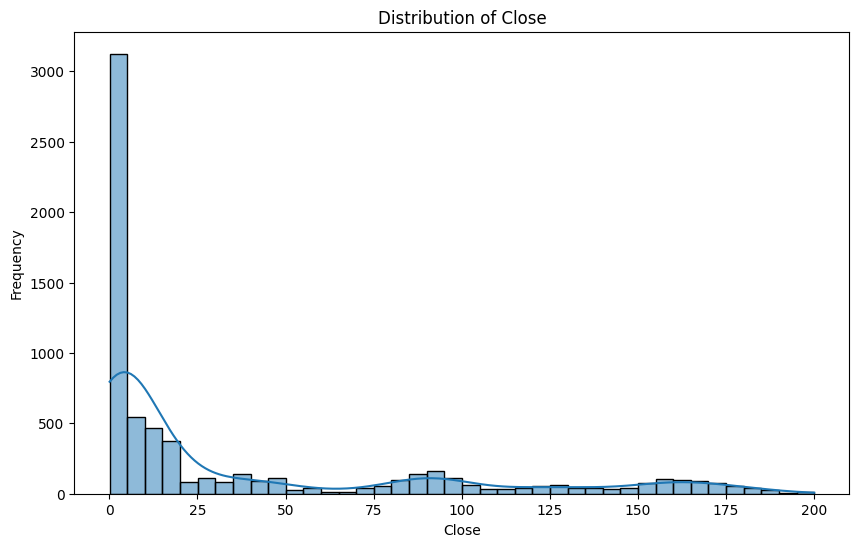

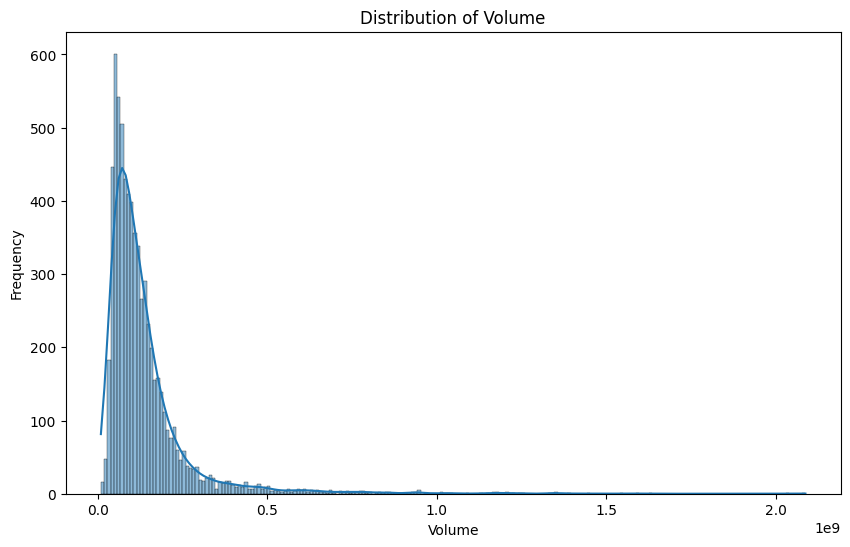

In [30]:
# Plot distributions
plot_distributions(df)

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\empyrical\stats.py:1424: RuntimeWarning:

divide by zero encountered in scalar divide

c:\Users\Darkles\10academy\10Academy-Kifiya-Week-1\env\Lib\site-packages\pyfolio\plotting.py:670: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-0.945%' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



Start date,1997-05-15
End date,2024-07-30
Total months,326
,Backtest
Annual return,-0.945%
Cumulative returns,-22.737%
Annual volatility,19.771%
Sharpe ratio,0.05
Calmar ratio,-0.01
Stability,0.27
Max drawdown,-82.083%


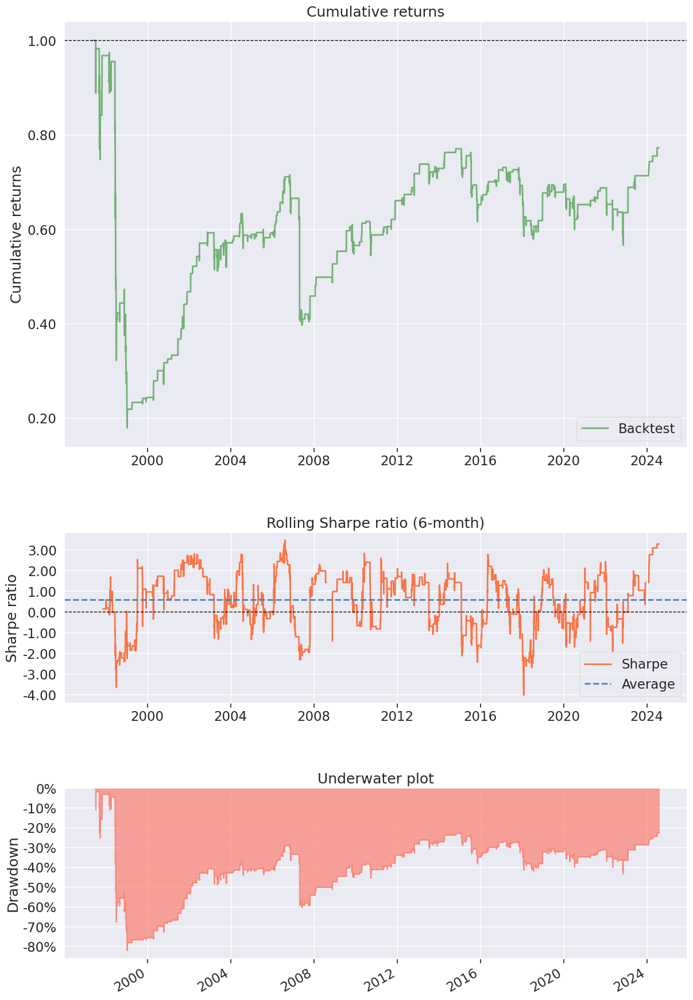

In [31]:
df['Signal'] = generate_signals(df)
df['Daily_Return'] = calculate_daily_return(df)
df['Strategy_Return'] = calculate_strategy_return(df)

create_performance_tear_sheet(df['Strategy_Return'])

In [32]:
# Calculate correlations
correlations = calculate_correlations(df, method="pearson")
correlations

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,1.000000,0.813507,0.813514,0.813609,0.813675,0.813675,-0.441691,NaN,0.010970,0.814125,...,0.814125,0.812703,0.753027,-0.099661,0.040722,-0.084633,-0.003225,-0.011310,-0.025039,0.010163
Open,0.813507,1.000000,0.999921,0.999904,0.999805,0.999805,-0.297579,NaN,0.016639,0.998434,...,0.998434,0.997736,0.921707,-0.125305,0.040632,-0.037743,-0.001409,0.007219,-0.016130,0.003303
High,0.813514,0.999921,1.000000,0.999885,0.999908,0.999908,-0.296579,NaN,0.017159,0.998464,...,0.998464,0.997633,0.923405,-0.124804,0.041192,-0.037360,-0.000562,0.006796,-0.013561,0.003271
Low,0.813609,0.999904,0.999885,1.000000,0.999914,0.999914,-0.298666,NaN,0.016668,0.998246,...,0.998246,0.997722,0.919694,-0.126137,0.043339,-0.036377,0.001454,0.005590,-0.013278,0.002899
Close,0.813675,0.999805,0.999908,0.999914,1.000000,1.000000,-0.297628,NaN,0.016564,0.998288,...,0.998288,0.997612,0.921486,-0.125570,0.043199,-0.036172,0.001613,0.005341,-0.010538,0.002966
Adj Close,0.813675,0.999805,0.999908,0.999914,1.000000,1.000000,-0.297628,NaN,0.016564,0.998288,...,0.998288,0.997612,0.921486,-0.125570,0.043199,-0.036172,0.001613,0.005341,-0.010538,0.002966
Volume,-0.441691,-0.297579,-0.296579,-0.298666,-0.297628,-0.297628,1.000000,NaN,0.016065,-0.298253,...,-0.298253,-0.300970,-0.239288,0.182160,0.053727,0.210093,-0.006554,-0.115662,0.161517,-0.145711
Dividends,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Stock Splits,0.010970,0.016639,0.017159,0.016668,0.016564,0.016564,0.016065,NaN,1.000000,0.013969,...,0.013969,0.012439,0.035650,0.015715,0.015557,0.020088,0.092600,-0.002278,0.009494,-0.007512
SMA,0.814125,0.998434,0.998464,0.998246,0.998288,0.998288,-0.298253,NaN,0.013969,1.000000,...,1.000000,0.998993,0.927013,-0.127600,0.013910,-0.054957,-0.047967,0.023053,-0.019399,0.003532


In [33]:
# Detect outliers
outliers = detect_outliers(df, column="Close", method="iqr")
outliers

,Date,Open,High,Low,Close,Adj Close,Volume,Dividends,Stock Splits,SMA,...,BB_middle,BB_lower,ATR,ADX,CCI,ROC,MACD_hist,Signal,Daily_Return,Strategy_Return
Date,,,,,,,,,,,,,,,,,,,,,
2020-04-30,2020-04-30,120.991997,123.750000,119.800499,123.699997,123.699997,190692000,0.0,0.0,112.237775,...,112.237775,94.100888,4.100427,34.437057,83.691158,2.732755,0.298482,0,0.042690,0.0
2020-05-20,2020-05-20,123.893501,125.000504,123.363503,124.897003,124.897003,79962000,0.0,0.0,119.177001,...,119.177001,113.913655,3.311649,27.488844,193.728584,6.238357,-0.113977,0,0.019846,0.0
2020-06-01,2020-06-01,122.400002,123.846497,122.208504,123.552002,123.552002,58578000,0.0,0.0,120.171701,...,120.171701,115.465774,3.099808,24.924298,106.066837,2.542144,-0.404078,0,0.011739,0.0
2020-06-02,2020-06-02,123.349998,123.676498,122.265503,123.620499,123.620499,50598000,0.0,0.0,120.562751,...,120.562751,116.080600,2.979179,24.549257,95.569755,1.902100,-0.320596,0,0.000554,0.0
2020-06-03,2020-06-03,123.400497,124.400002,123.058502,123.919998,123.919998,53420000,0.0,0.0,120.964251,...,120.964251,116.801058,2.862202,24.418806,105.270349,1.186854,-0.257663,0,0.002423,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-24,2024-07-24,183.199997,185.449997,180.410004,180.830002,180.830002,41532400,0.0,0.0,192.890000,...,192.890000,180.223416,4.737086,26.846765,-139.870448,-9.489961,-1.977124,0,-0.029934,-0.0
2024-07-25,2024-07-25,182.910004,183.899994,176.800003,179.850006,179.850006,44464200,0.0,0.0,192.202000,...,192.202000,178.329236,4.905865,27.294543,-139.045070,-7.792872,-2.010878,0,-0.005419,-0.0
2024-07-26,2024-07-26,180.389999,183.190002,180.240005,182.500000,182.500000,29506000,0.0,0.0,191.434500,...,191.434500,177.202735,4.794017,27.710338,-102.504451,-6.164844,-1.758711,0,0.014734,0.0


In [34]:
# Time-based aggregation
time_based_aggregation(df, time_column="Date", agg_column="Close", freq="ME", agg_func="mean")

,Date,Close
0,1997-05-31,0.079427
1,1997-06-30,0.076885
2,1997-07-31,0.110275
3,1997-08-31,0.111570
4,1997-09-30,0.174628
...,...,...
322,2024-03-31,176.822500
323,2024-04-30,181.173182
324,2024-05-31,184.176365
325,2024-06-30,186.084211
